# Earthquake_basemap
> Non-Euclidean geometry

- toc:true
- branch: master
- badges: true
- comments: false
- author: 최서연
- categories: [Graph Laplacian, PCA, eigendecomposition]

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import networkx as nx

In [3]:
import warnings
warnings.simplefilter("ignore", np.ComplexWarning)

In [4]:
!pip install haversine

In [5]:
from haversine import haversine

In [6]:
import time

##### 1. Data

In [7]:
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/earthquakes-23k.csv')

In [8]:
_df = df.assign(Year=list(map(lambda x: x.split('/')[-1], df.Date))).query('Year>="2004" & Year<="2011"').reset_index().iloc[:,1:]

##### 2. $f(x)$ 

In [9]:
f_true = np.array(_df.loc[:,"Magnitude"])

In [10]:
f = (f_true-f_true.mean())/f_true.std()

In [11]:
f@f ## SST 

4517.000000000005

In [12]:
(f-np.mean(f))@(f-np.mean(f)) ## SSE

4517.000000000003

In [13]:
(f*0-np.mean(f))@(f*0-np.mean(f)) ## SSH

3.022296055212013e-29

##### 3. Haversine Fomula 사용한 거리 정의

In [14]:
locations = np.array(_df.iloc[:,[1,2]])

In [15]:
N = len(f)

In [16]:
dist_matrix = np.zeros((N,N))

In [17]:
for i in range(N):
    for j in range(i,N): 
        dist_matrix[i,j]=haversine(locations[i],locations[j])

In [18]:
dist_matrix = dist_matrix + dist_matrix.T

In [19]:
dist_matrix

array([[    0.        ,  5961.60560635, 10594.64532549, ...,
          283.48765909, 10831.08154775,  5512.17788275],
       [ 5961.60560635,     0.        , 15875.7469962 , ...,
         5819.50260123,  6953.06020638,  9935.96013871],
       [10594.64532549, 15875.7469962 ,     0.        , ...,
        10636.49108416, 12127.14372591,  9114.83672805],
       ...,
       [  283.48765909,  5819.50260123, 10636.49108416, ...,
            0.        , 10553.19437367,  5793.83248054],
       [10831.08154775,  6953.06020638, 12127.14372591, ...,
        10553.19437367,     0.        , 16312.45397939],
       [ 5512.17788275,  9935.96013871,  9114.83672805, ...,
         5793.83248054, 16312.45397939,     0.        ]])

##### 4. Definition of a weighted adjacency matrix $W$

$$W_{u,v}=\begin{cases}{exp(-\frac{[dist(u,v)]^2}{2\theta^2})} & \quad \text{if } dist(u,v) \leq κ \\ 0 & \quad \text{otherwise} \end{cases}$$

In [27]:
theta,kappa = 8000, 100000

In [28]:
W = np.exp( -0.5*(dist_matrix/theta)**2)

(array([1984746., 1644882., 1741876., 1600032., 1698914., 1725998.,
        2059100., 2235924., 2185936., 3525881.]),
 array([0.0438522 , 0.13946698, 0.23508176, 0.33069654, 0.42631132,
        0.5219261 , 0.61754088, 0.71315566, 0.80877044, 0.90438522,
        1.        ]),
 <a list of 10 Patch objects>)

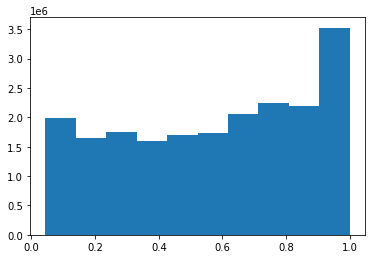

In [29]:
plt.hist(W.reshape(-1))

##### 5. The weight edge function with temporal edge $(v_t,v_{t+1})$

$$W_{u_r,v_s}=\begin{cases} {W_{u,v}} & \quad \text{ if }  u,v \in V_t  \\ W_{u,v} \odot \beta  & \quad \text{if }u=v \text{ and } r=s-1 \\ 0 & \quad \text{otherwise} \end{cases}$$

In [30]:
Nlst = _df.groupby("Year").aggregate(len).Date.tolist()
Nlst = np.cumsum(Nlst)

In [31]:
a=0
_beta =np.zeros((N,N))
for i in range(len(Nlst)):
    b=Nlst[i] 
    _beta[a:b,a:b]= np.ones(b-a)
    a=Nlst[i]

In [32]:
_W = W @ _beta

##### 6. Definition of Graph Laplacian matrix
- $L = D - W$

In [33]:
D = np.diag(_W.sum(axis=1))

In [34]:
L = D - _W

##### 7. Eigendecomposition
- ${\bf L} = {\boldsymbol\Psi} {\boldsymbol\Lambda} {\boldsymbol\Psi}^\top$

In [35]:
λ, Ψ = np.linalg.eig(L)

In [36]:
Λ = np.diag(λ)

##### 8. Principal components Analysis

- $comp_k = f @ np.outer(Ψ[:,k], Ψ[:,k]) $
    - $k = 1, 2, 3, n$
- $p = \sum_{1}^{n} comp_{1}^{2},\sum_{1}^{n} comp_{2}^{2},…,\sum_{1}^{n} comp_{n}^{2}$
- $p = \frac{p}{\sum(p)}$

In [37]:
def p(i):
    return sum((f @ np.outer( Ψ[:,i], Ψ[:,i]))**2)

In [38]:
array_1 = np.array([p(i) for i in range(1,len(f))])
varprop = array_1/array_1.sum()
_index = pd.DataFrame({'index':range(1,len(f)),'varprop':varprop}).sort_values('varprop',ascending=False)
_indexlst = _index.iloc[:25,0].tolist()

In [39]:
_df["comp1"] = f @ np.outer( Ψ[:,0], Ψ[:,0])
_df["comp2"] = f @ np.outer( Ψ[:,_indexlst[0]], Ψ[:,_indexlst[0]])
_df["comp3"] = f @ np.outer( Ψ[:,_indexlst[1]], Ψ[:,_indexlst[1]])
_df["comp4"] = f @ np.outer( Ψ[:,_indexlst[2]], Ψ[:,_indexlst[2]])
_df["comp5"] = f @ np.outer( Ψ[:,_indexlst[3]], Ψ[:,_indexlst[3]])
_df["comp6"] = f @ np.outer( Ψ[:,_indexlst[4]], Ψ[:,_indexlst[4]])
_df["comp7"] = f @ np.outer( Ψ[:,_indexlst[5]], Ψ[:,_indexlst[5]])

In [40]:
#collapse

from itertools import chain
def draw_map(m, scale=0.2):
    # draw a shaded-relief image
    m.shadedrelief(scale=scale)
    
    # lats and longs are returned as a dictionary
    lats = m.drawparallels(np.linspace(-90, 90, 13))
    lons = m.drawmeridians(np.linspace(-180, 180, 13))

    # keys contain the plt.Line2D instances
    lat_lines = chain(*(tup[1][0] for tup in lats.items()))
    lon_lines = chain(*(tup[1][0] for tup in lons.items()))
    all_lines = chain(lat_lines, lon_lines)
    
    # cycle through these lines and set the desired style
    for line in all_lines:
        line.set(linestyle='-', alpha=0.3, color='w')

In [41]:
!pip install Basemap

     |████████████████████████████████| 862 kB 16.3 MB/s 
     |████████████████████████████████| 219 kB 40.2 MB/s 
     |████████████████████████████████| 6.3 MB 36.0 MB/s 
     |████████████████████████████████| 30.5 MB 71.8 MB/s 
  Created wheel for pyshp: filename=pyshp-2.1.3-py3-none-any.whl size=37324 sha256=985448b1b60a610ae27766d62f559201f45d33df982fd1ffb72014f559f91b06
  Stored in directory: /root/.cache/pip/wheels/43/f8/87/53c8cd41545ba20e536ea29a8fcb5431b5f477ca50d5dffbbe
Successfully built pyshp


In [42]:
from mpl_toolkits.basemap import Basemap

In [43]:
m = Basemap(projection='cyl', resolution=None,
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180)

##### **2004**, $n=571$

In [44]:
_G1 = nx.Graph(_W[:len(_df.query('Year<="2004"')),:len(_df.query('Year<="2004"'))]-np.identity(len(_df.query('Year=="2004"'))))
_pos1 = nx.spring_layout(_G1,iterations=20)
m_pos1 = list(zip(_df.query('Year=="2004"').Longitude,_df.query('Year=="2004"').Latitude))

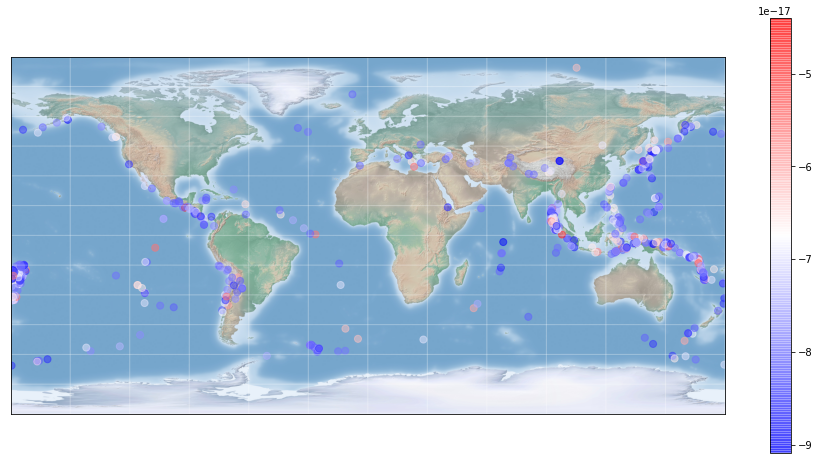

In [45]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

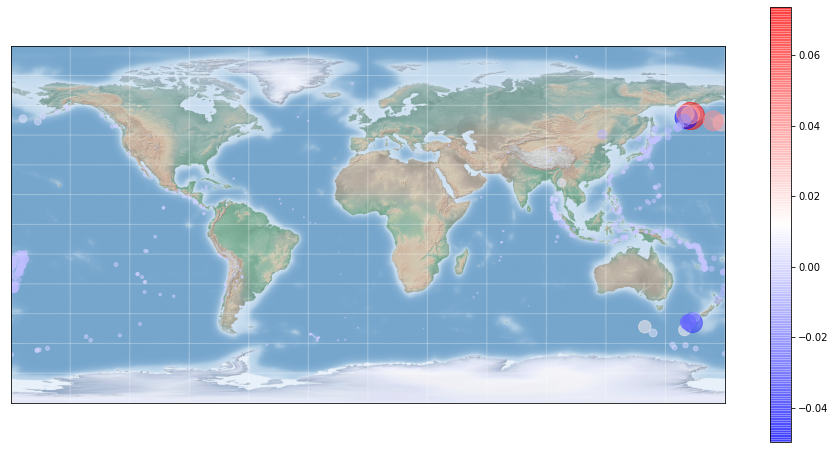

In [46]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp2,node_size = np.abs(_df.query('Year=="2004"').comp2)*10000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

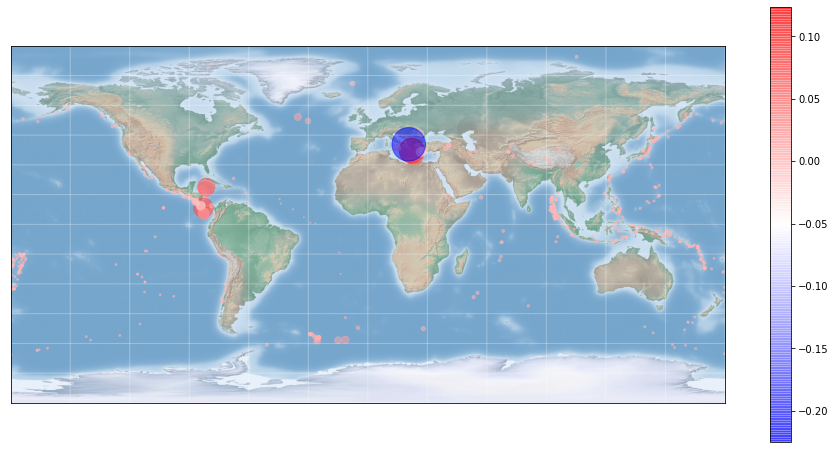

In [49]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp3,node_size = np.abs(_df.query('Year=="2004"').comp3)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

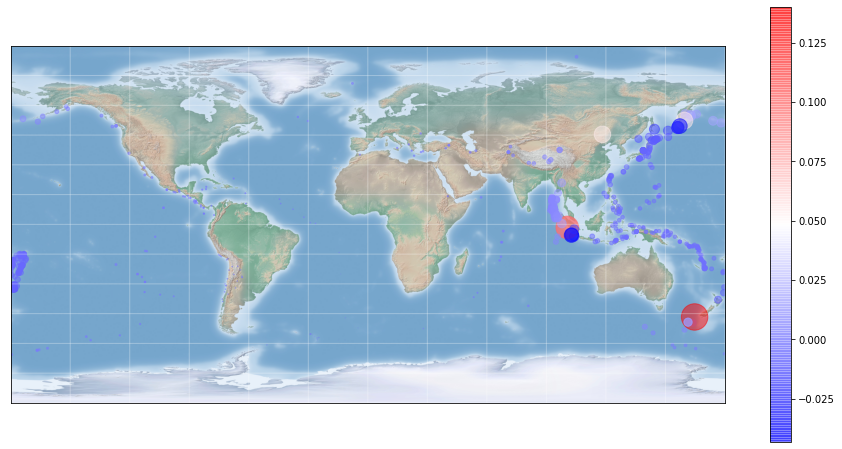

In [53]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp4,node_size = np.abs(_df.query('Year=="2004"').comp4)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

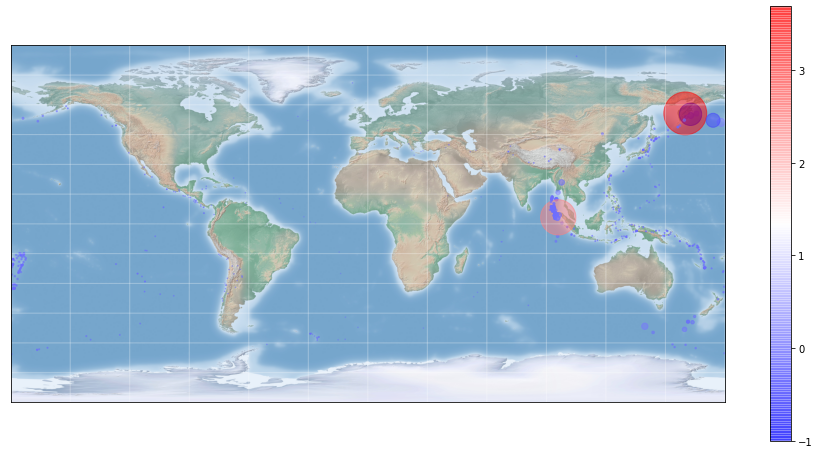

In [57]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp5,node_size = np.abs(_df.query('Year=="2004"').comp5)*500, ax=ax,cmap='bwr', alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

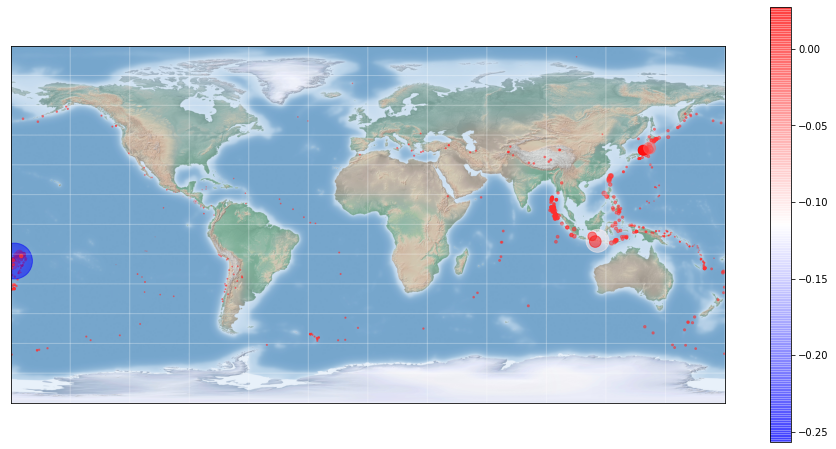

In [58]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp6,node_size = np.abs(_df.query('Year=="2004"').comp6)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

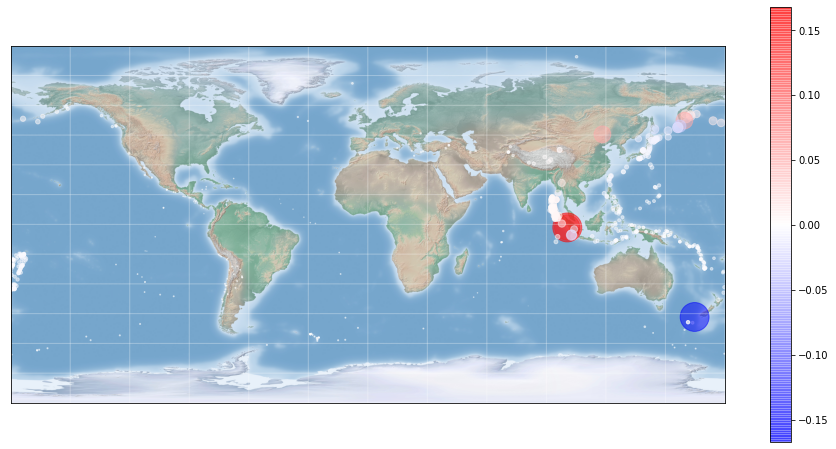

In [60]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp7,node_size = np.abs(_df.query('Year=="2004"').comp7)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2005**, $n=533$

In [61]:
_G2 = nx.Graph(_W[len(_df.query('Year<="2004"')):len(_df.query('Year<="2005"')),len(_df.query('Year<="2004"')):len(_df.query('Year<="2005"'))]-np.identity(len(_df.query('Year=="2005"'))))
_pos2 = nx.spring_layout(_G2,iterations=20)
m_pos2 = list(zip(_df.query('Year=="2005"').Longitude,_df.query('Year=="2005"').Latitude))

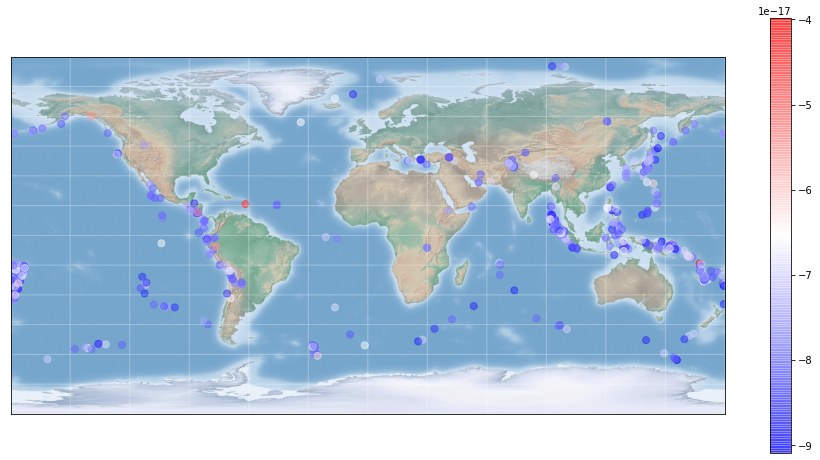

In [62]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp1,node_size=50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

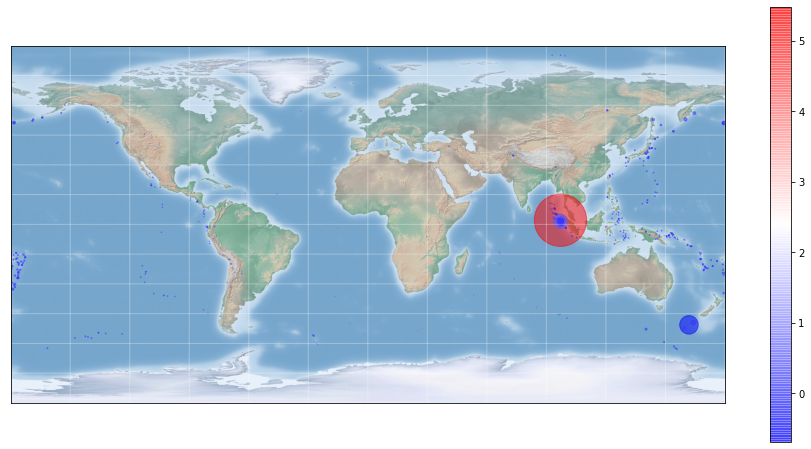

In [65]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp2,node_size = np.abs(_df.query('Year=="2005"').comp2)*500,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

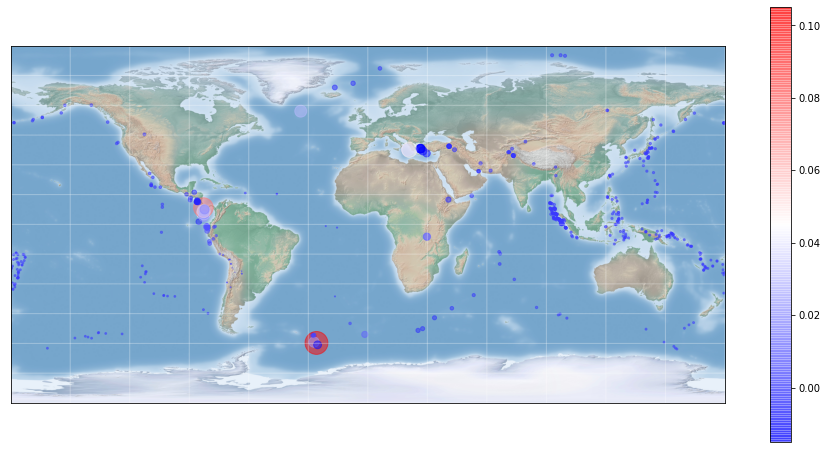

In [68]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp3,node_size = np.abs(_df.query('Year=="2005"').comp3)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

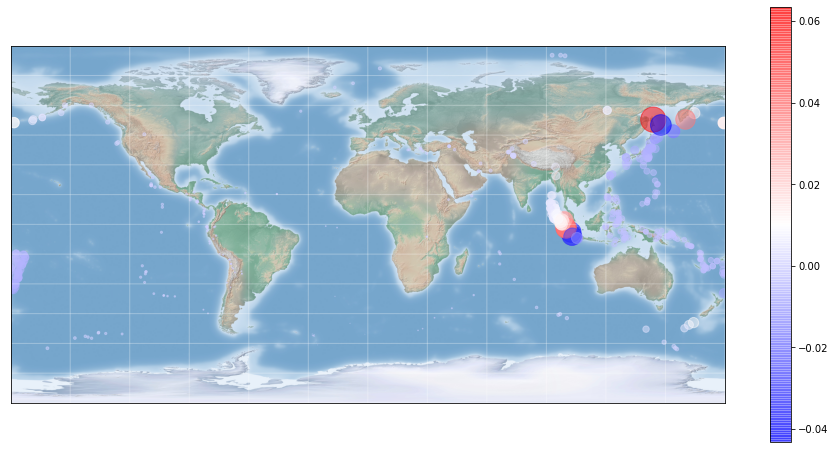

In [69]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp4,node_size = np.abs(_df.query('Year=="2005"').comp4)*10000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

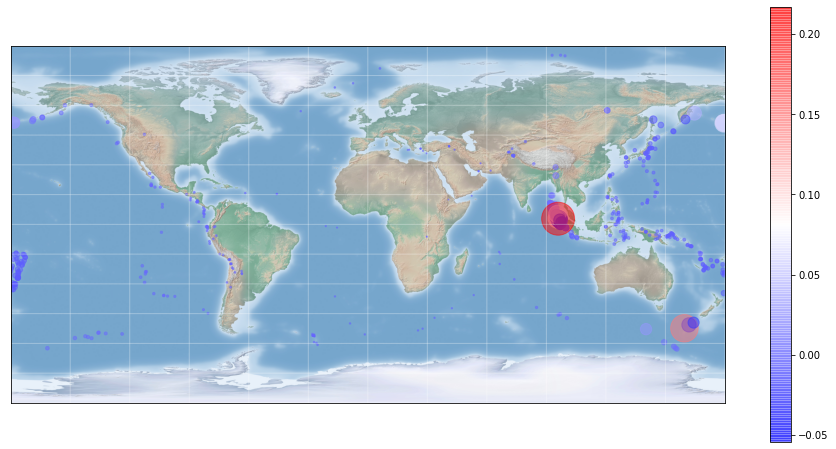

In [72]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp5,node_size = np.abs(_df.query('Year=="2005"').comp5)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

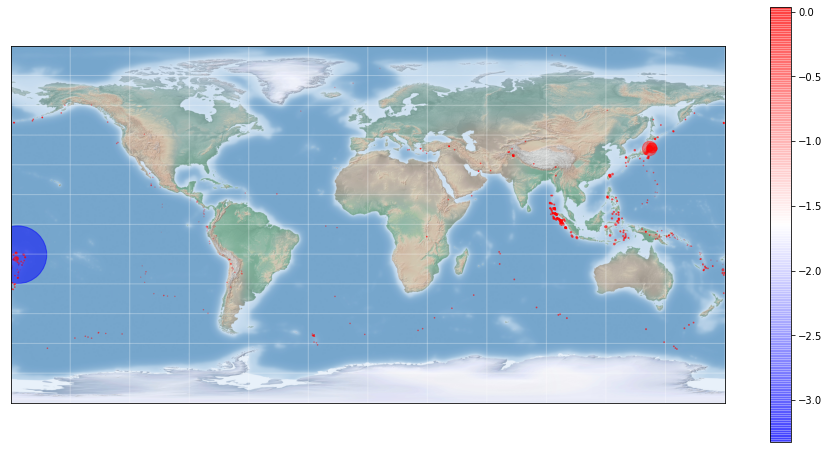

In [74]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp6,node_size = np.abs(_df.query('Year=="2005"').comp6)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

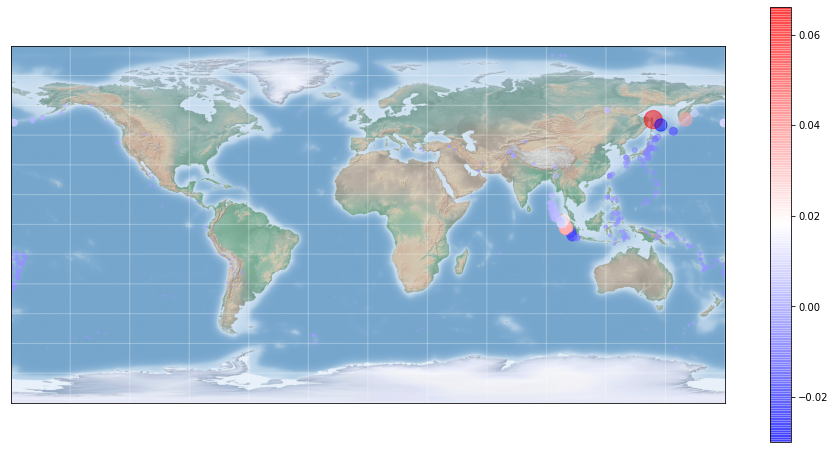

In [76]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp7, node_size = np.abs(_df.query('Year=="2005"').comp7)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2006**, $n=512$

In [77]:
_G3 = nx.Graph(_W[len(_df.query('Year<="2005"')):len(_df.query('Year<="2006"')),len(_df.query('Year<="2005"')):len(_df.query('Year<="2006"'))]-np.identity(len(_df.query('Year=="2006"'))))
_pos3 = nx.spring_layout(_G3,iterations=20)
m_pos3 = list(zip(_df.query('Year=="2006"').Longitude,_df.query('Year=="2006"').Latitude))

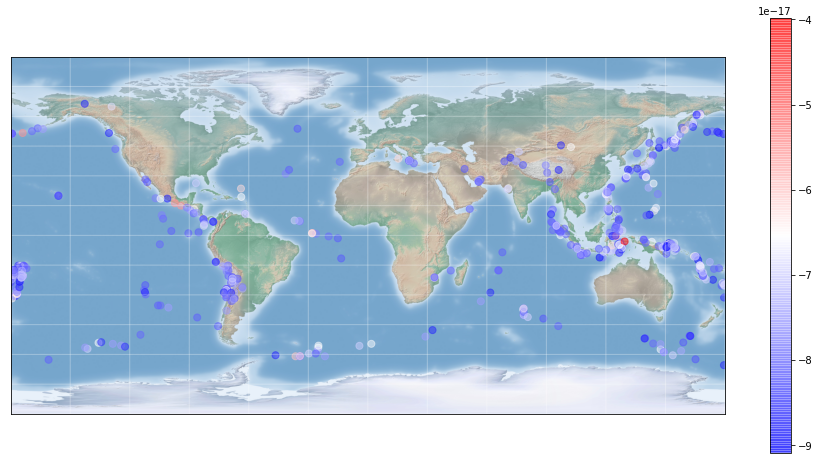

In [78]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp1,node_size=50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

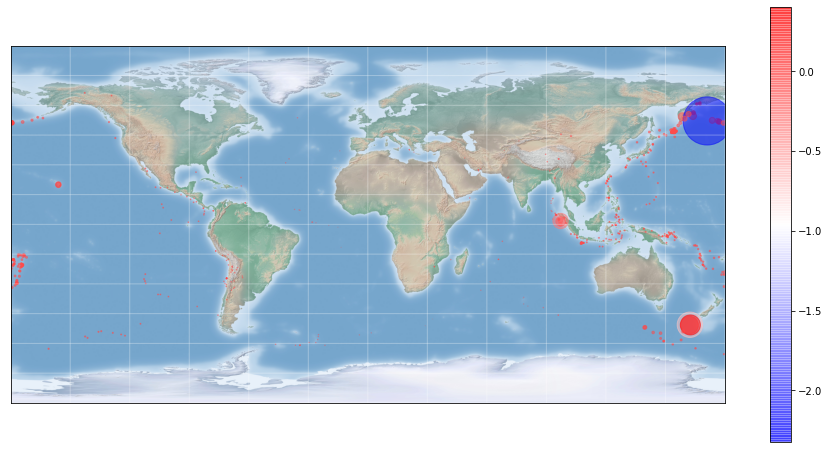

In [80]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp2,node_size = np.abs(_df.query('Year=="2006"').comp2)*1000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

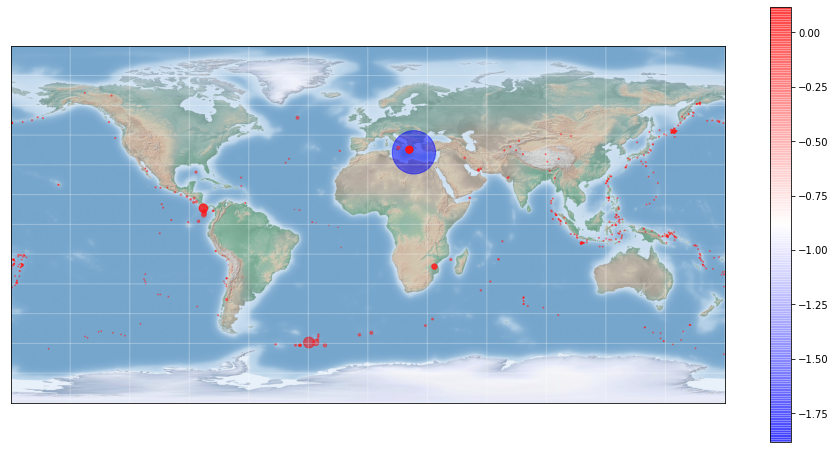

In [82]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp3,node_size = np.abs(_df.query('Year=="2006"').comp3)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

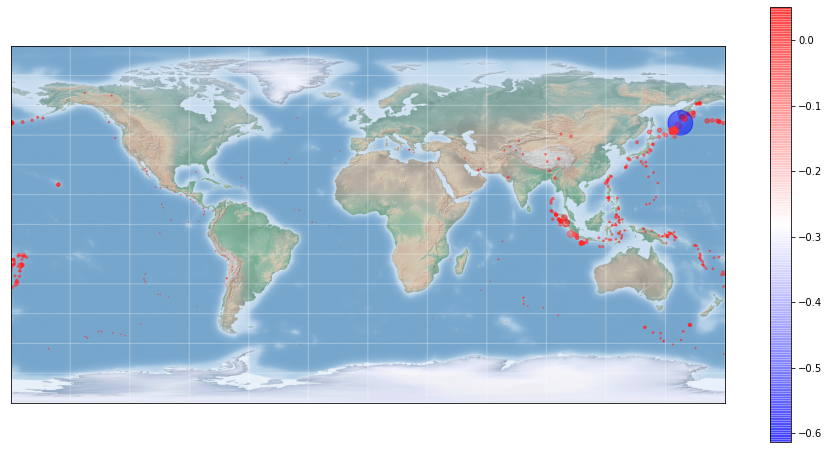

In [84]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp4,node_size = np.abs(_df.query('Year=="2006"').comp4)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

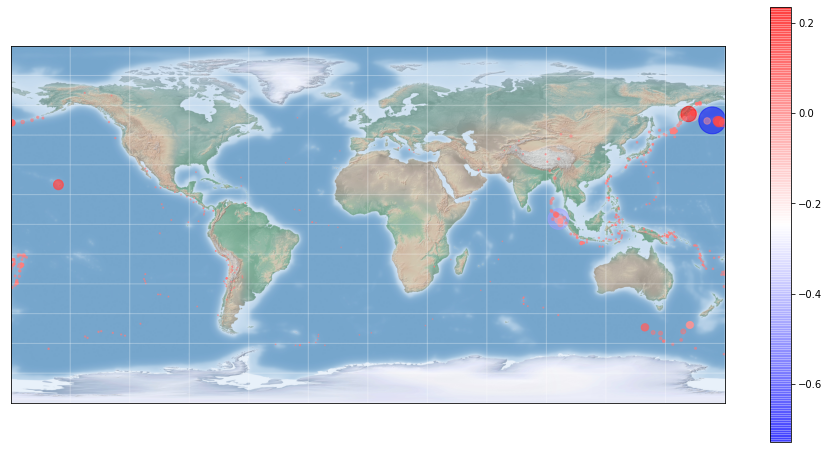

In [86]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp5,node_size = np.abs(_df.query('Year=="2006"').comp5)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

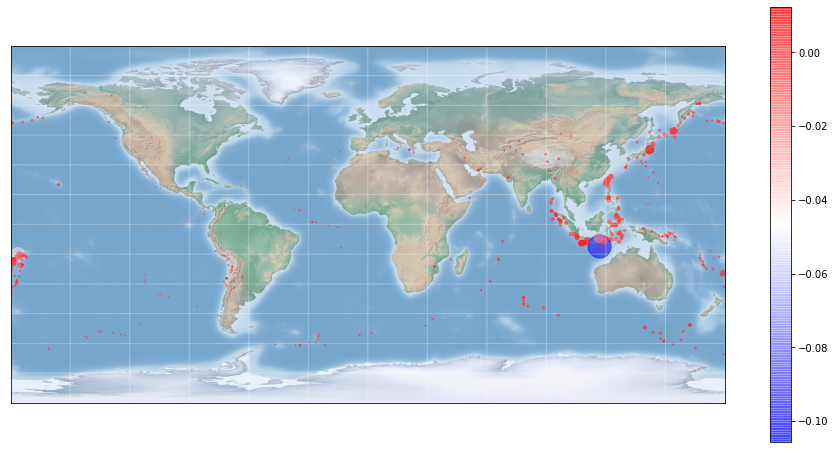

In [88]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp6,node_size = np.abs(_df.query('Year=="2006"').comp6)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

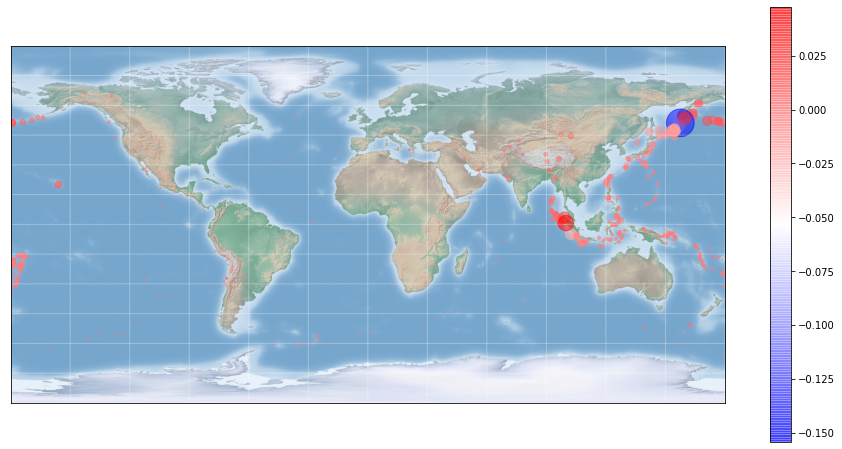

In [91]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp7,node_size = np.abs(_df.query('Year=="2006"').comp7)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2007**, $n=608$

In [92]:
_G4 = nx.Graph(_W[len(_df.query('Year<="2006"')):len(_df.query('Year<="2007"')),len(_df.query('Year<="2006"')):len(_df.query('Year<="2007"'))]-np.identity(len(_df.query('Year=="2007"'))))
_pos4 = nx.spring_layout(_G4,iterations=20)
m_pos4 = list(zip(_df.query('Year=="2007"').Longitude,_df.query('Year=="2007"').Latitude))

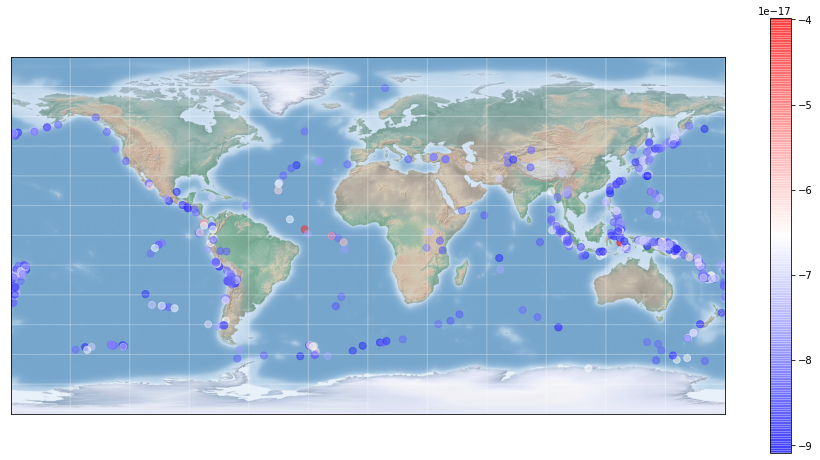

In [93]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

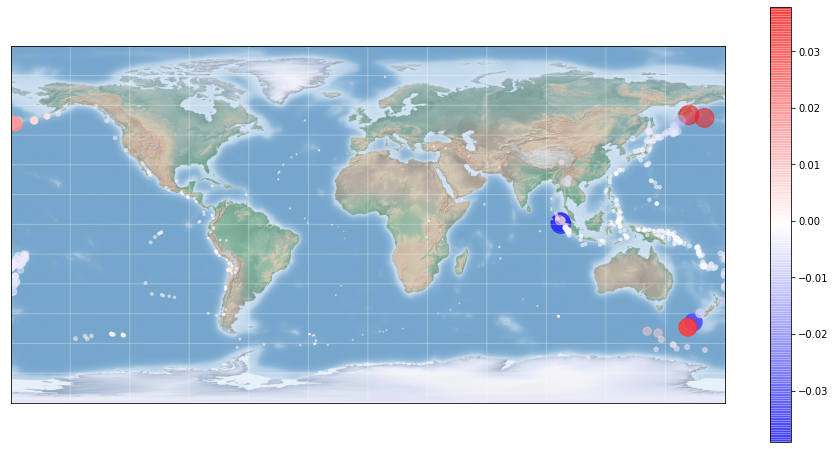

In [96]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp2,node_size = np.abs(_df.query('Year=="2007"').comp2)*10000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

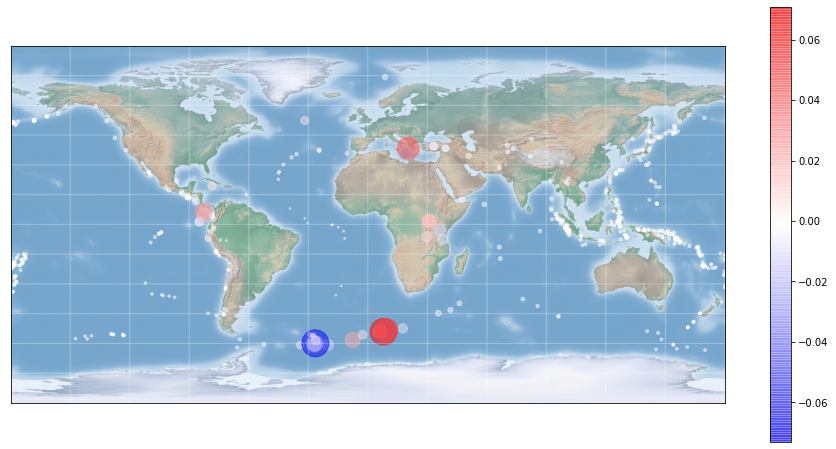

In [98]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp3,node_size =np.abs(_df.query('Year=="2007"').comp3)*10000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

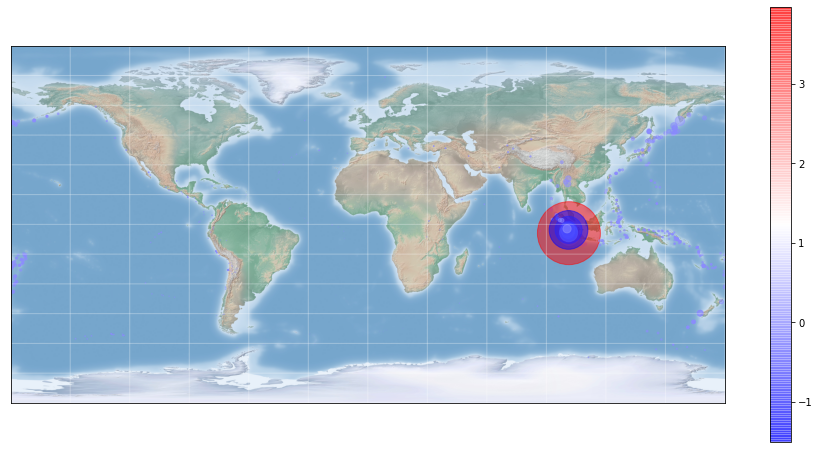

In [100]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp4,node_size = np.abs(_df.query('Year=="2007"').comp4)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

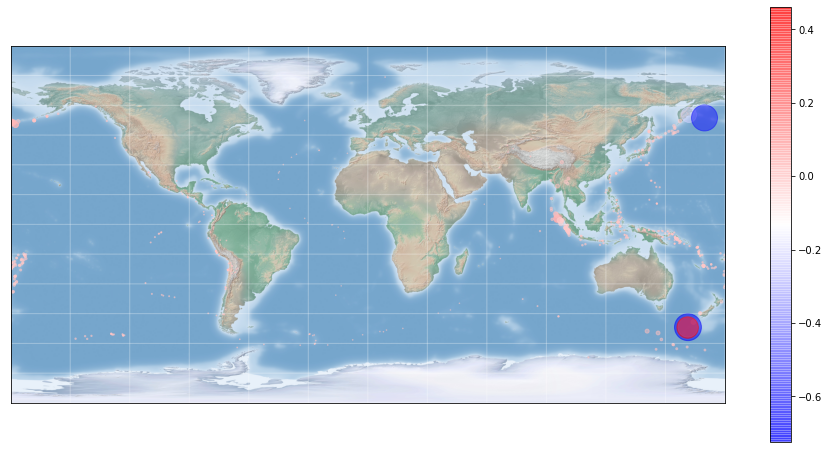

In [101]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp5,node_size = np.abs(_df.query('Year=="2007"').comp5)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

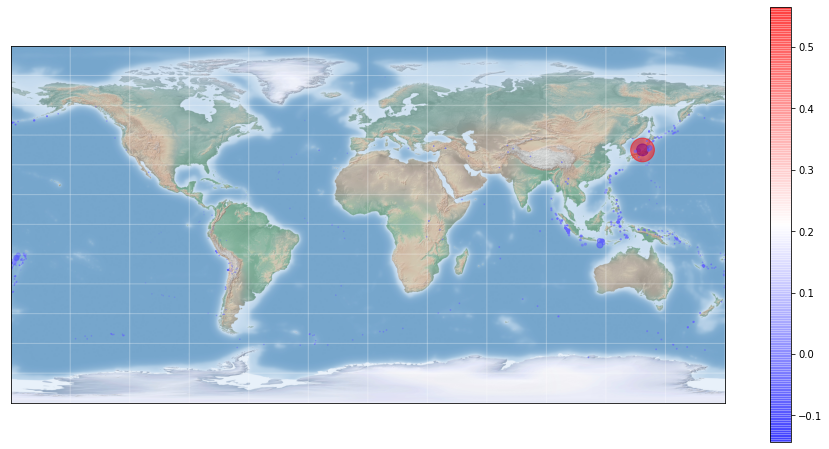

In [103]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp6,node_size = np.abs(_df.query('Year=="2007"').comp6)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

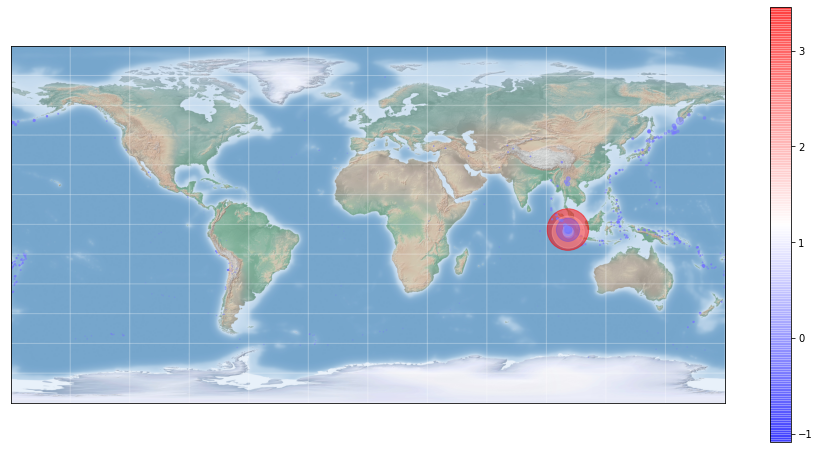

In [107]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp7,node_size = np.abs(_df.query('Year=="2007"').comp7)*500, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2008**, $n=508$

In [108]:
_G5 = nx.Graph(_W[len(_df.query('Year<="2007"')):len(_df.query('Year<="2008"')),len(_df.query('Year<="2007"')):len(_df.query('Year<="2008"'))]-np.identity(len(_df.query('Year=="2008"'))))
_pos5 = nx.spring_layout(_G5,iterations=20)
m_pos5 = list(zip(_df.query('Year=="2008"').Longitude,_df.query('Year=="2008"').Latitude))

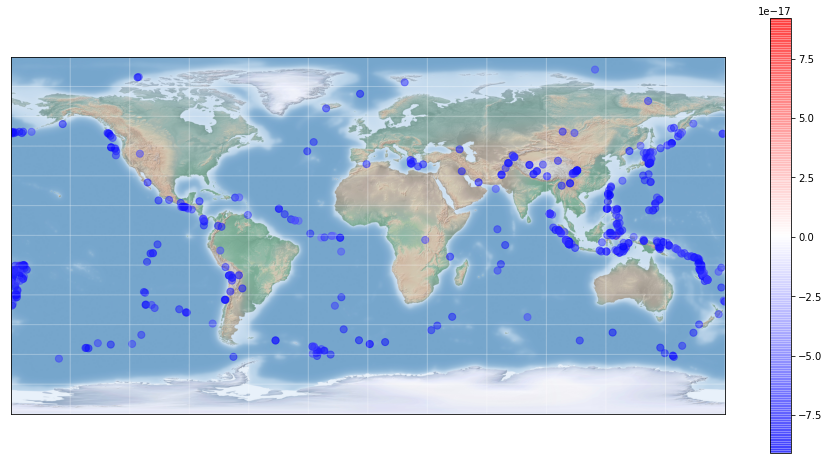

In [109]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

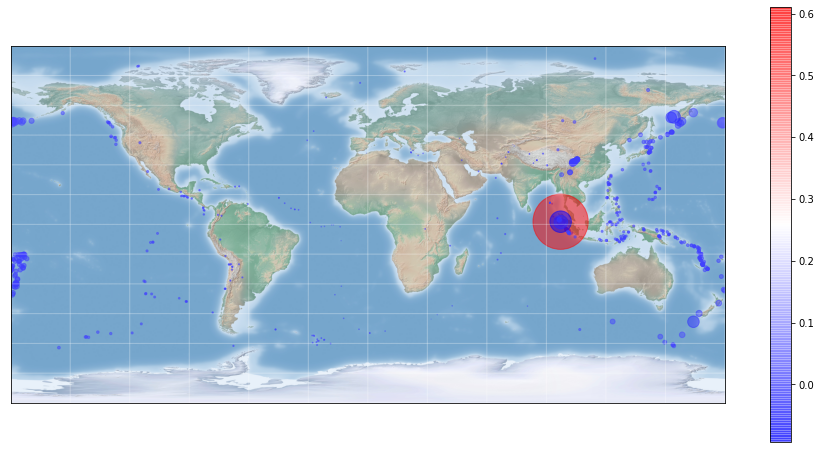

In [111]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp2,node_size = np.abs(_df.query('Year=="2008"').comp2)*5000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

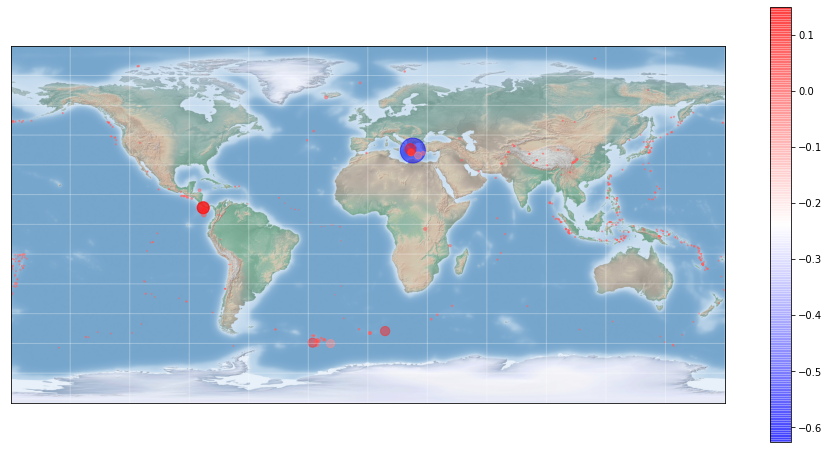

In [114]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp3,node_size = np.abs(_df.query('Year=="2008"').comp3)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

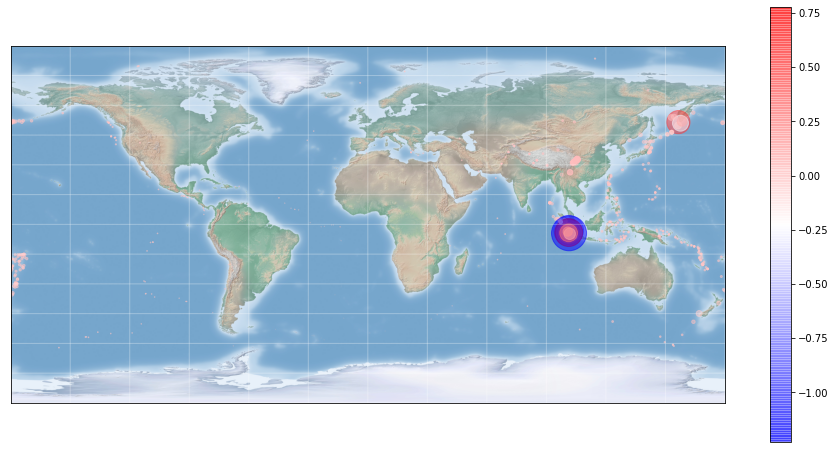

In [117]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp4,node_size = np.abs(_df.query('Year=="2008"').comp4)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

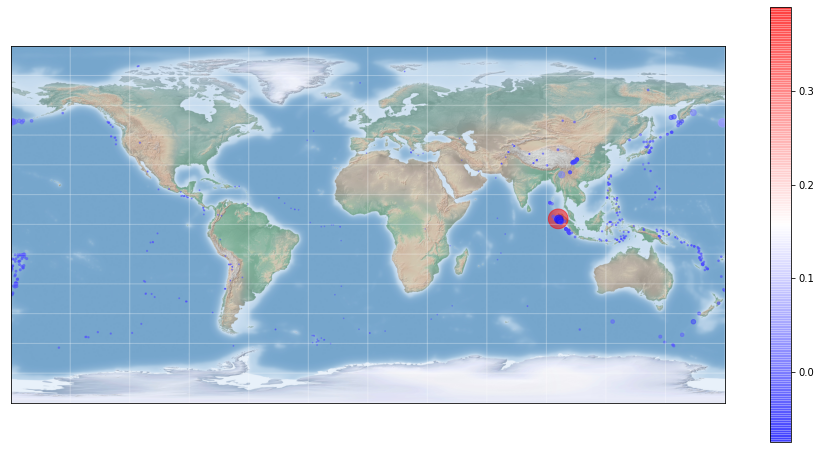

In [119]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp5,node_size = np.abs(_df.query('Year=="2008"').comp5)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

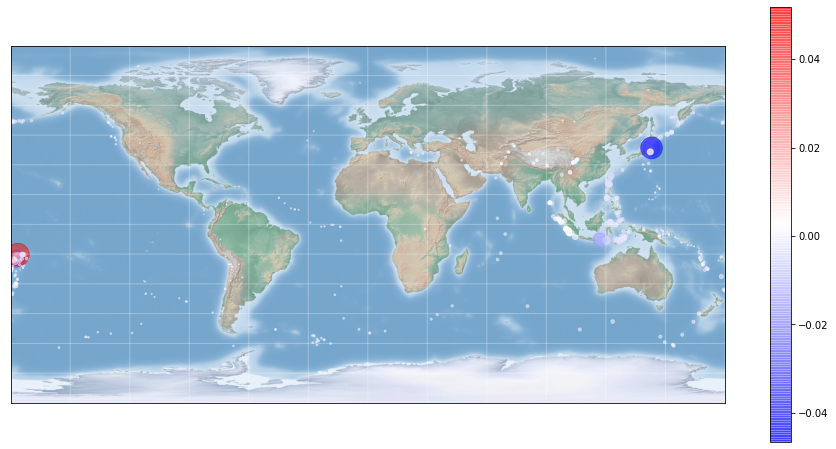

In [120]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp6,node_size = np.abs(_df.query('Year=="2008"').comp6)*10000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

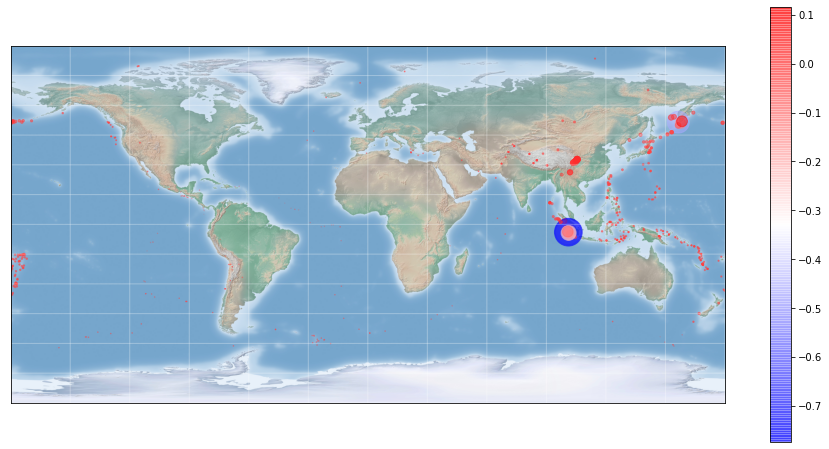

In [122]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp7,node_size = np.abs(_df.query('Year=="2008"').comp7)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2009**, $n=517$

In [123]:
_G6 = nx.Graph(_W[len(_df.query('Year<="2008"')):len(_df.query('Year<="2009"')),len(_df.query('Year<="2008"')):len(_df.query('Year<="2009"'))]-np.identity(len(_df.query('Year=="2009"'))))
_pos6 = nx.spring_layout(_G6,iterations=20)
m_pos6 = list(zip(_df.query('Year=="2009"').Longitude,_df.query('Year=="2009"').Latitude))

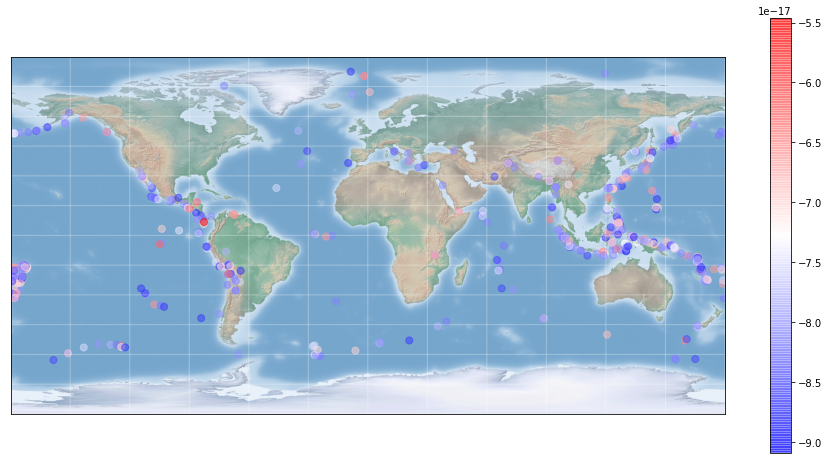

In [124]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

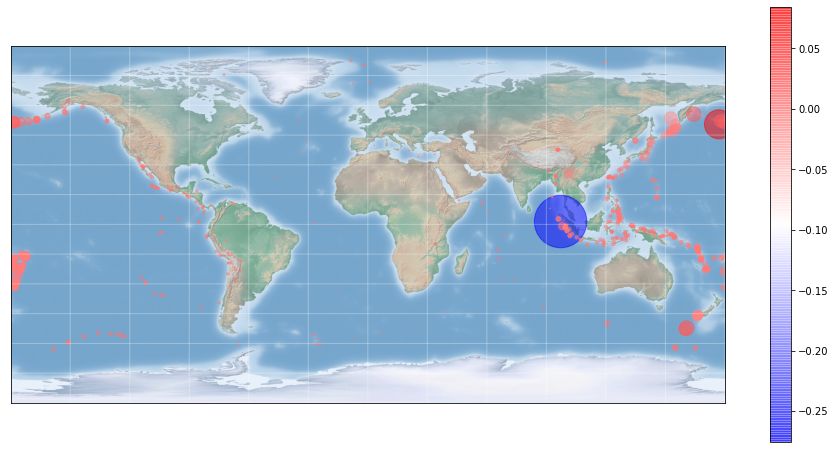

In [127]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp2,node_size = np.abs(_df.query('Year=="2009"').comp2)*10000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

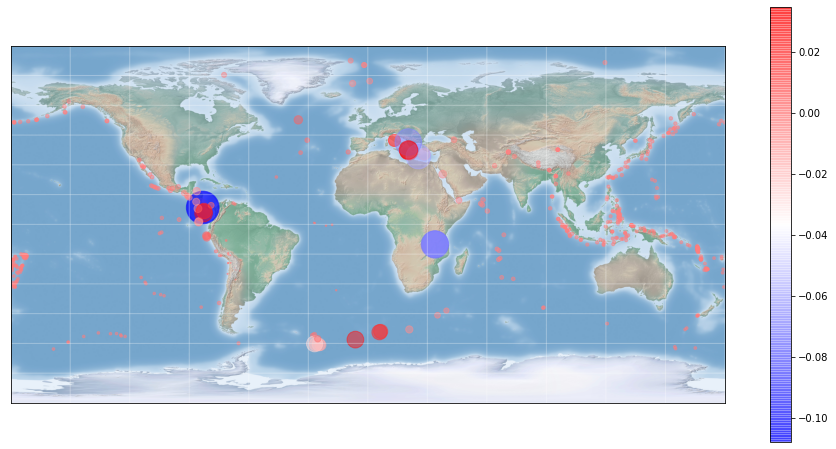

In [130]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp3,node_size = np.abs(_df.query('Year=="2009"').comp3)*10000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

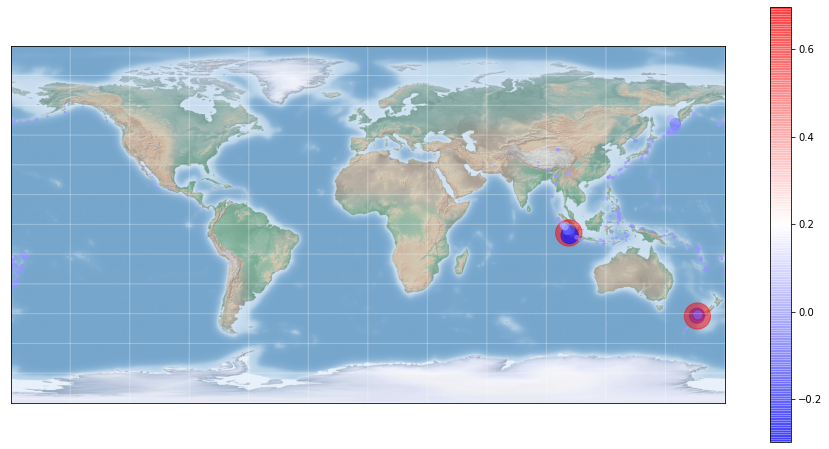

In [132]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp4,node_size = np.abs(_df.query('Year=="2009"').comp4)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

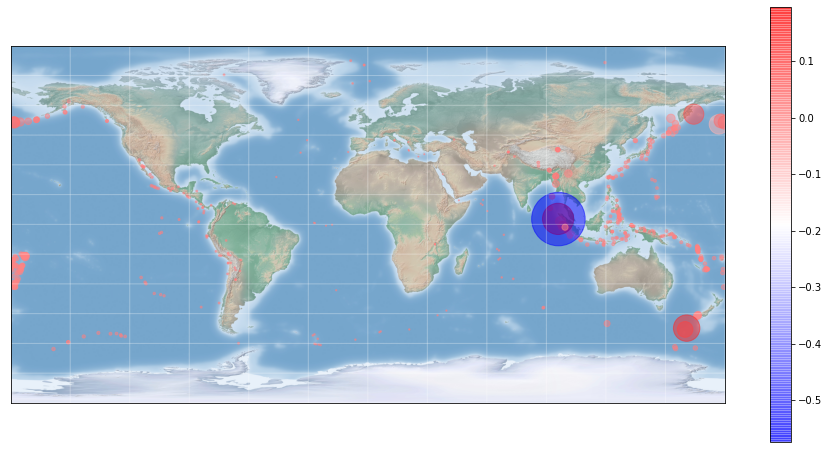

In [135]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp5,node_size = np.abs(_df.query('Year=="2009"').comp5)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

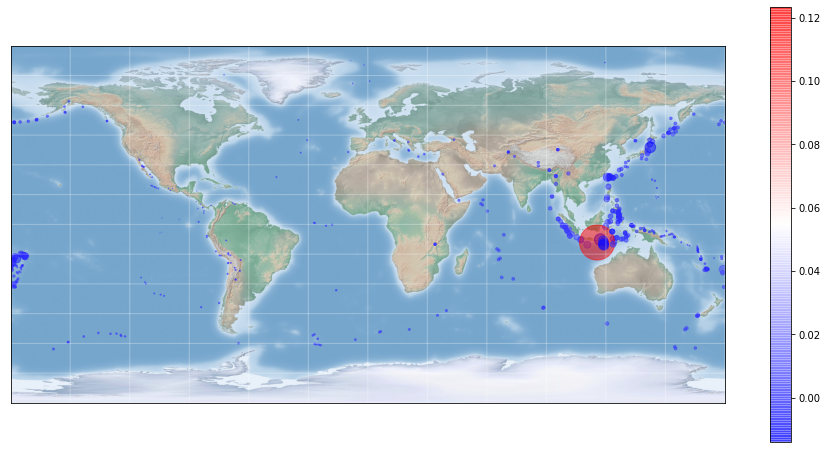

In [136]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp6,node_size = np.abs(_df.query('Year=="2009"').comp6)*10000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

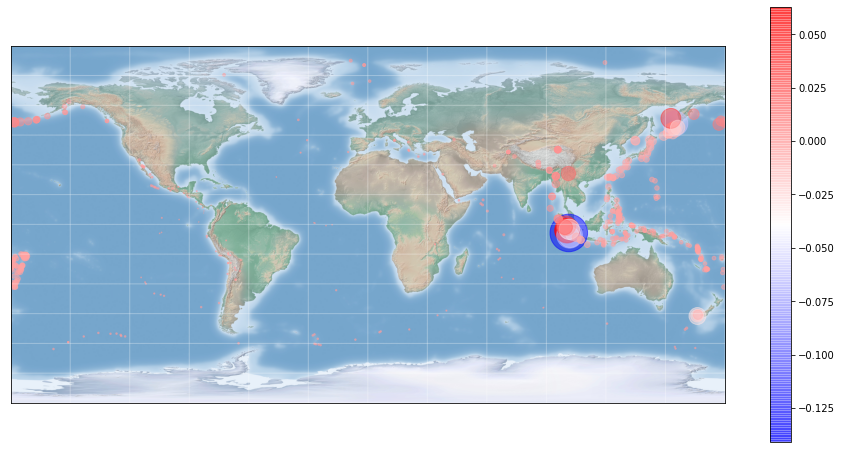

In [137]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp7,node_size = np.abs(_df.query('Year=="2009"').comp7)*10000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2010**, $n=560$

In [138]:
_G7 = nx.Graph(_W[len(_df.query('Year<="2009"')):len(_df.query('Year<="2010"')),len(_df.query('Year<="2009"')):len(_df.query('Year<="2010"'))]-np.identity(len(_df.query('Year=="2010"'))))
_pos7 = nx.spring_layout(_G7,iterations=20)
m_pos7 = list(zip(_df.query('Year=="2010"').Longitude,_df.query('Year=="2010"').Latitude))

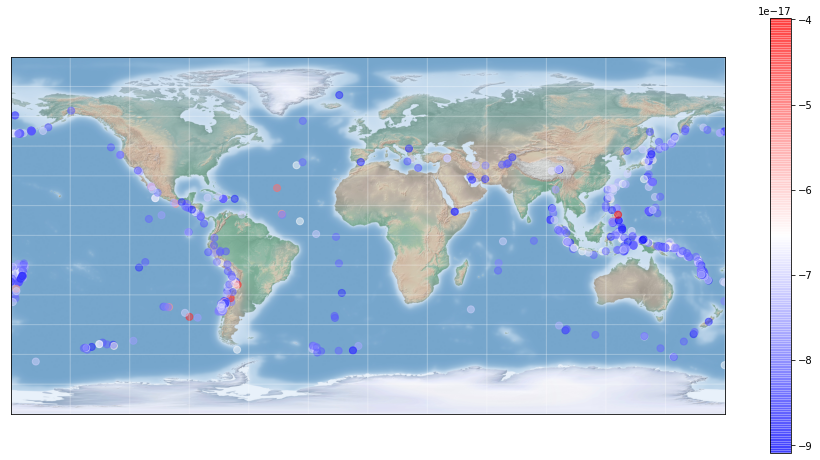

In [139]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

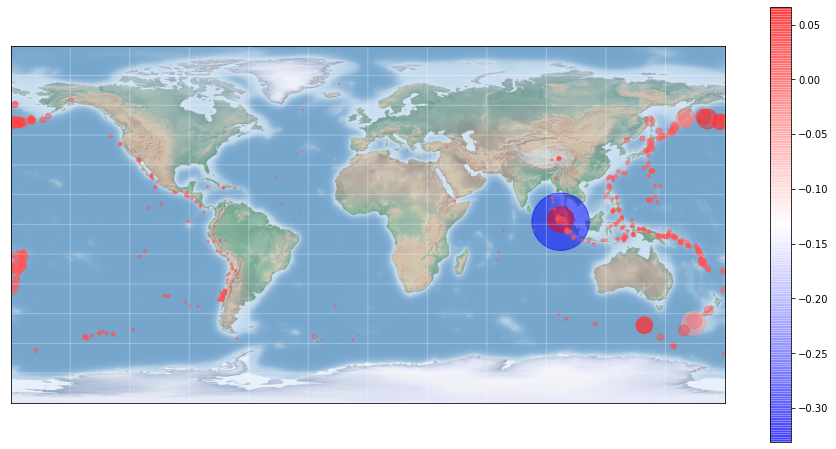

In [142]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp2,node_size = np.abs(_df.query('Year=="2010"').comp2)*10000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

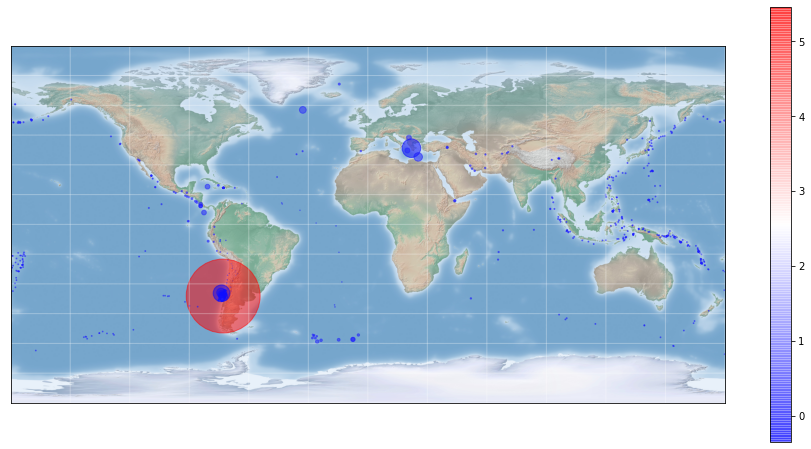

In [144]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp3,node_size = np.abs(_df.query('Year=="2010"').comp3)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

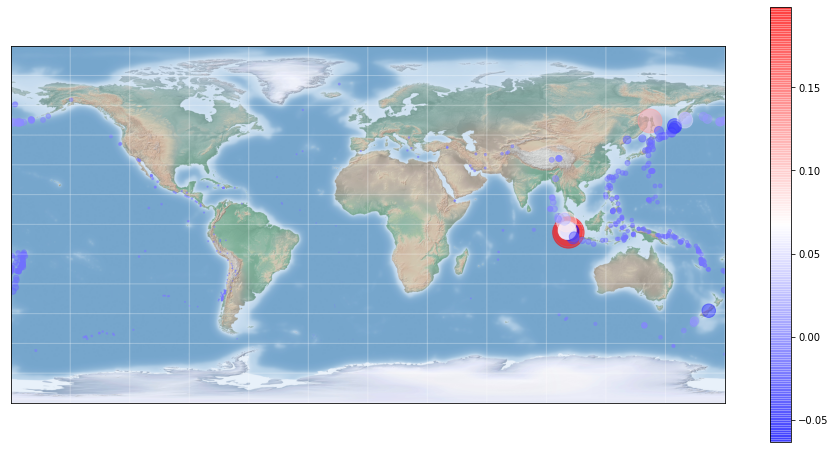

In [146]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp4,node_size = np.abs(_df.query('Year=="2010"').comp4)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

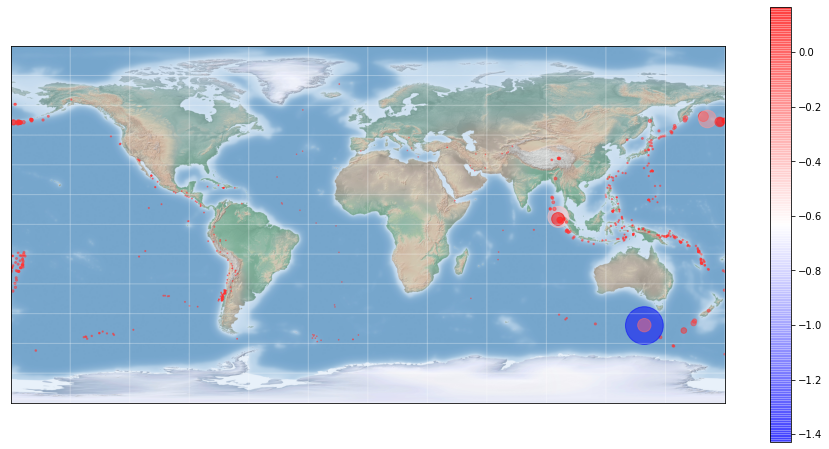

In [149]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp5,node_size = np.abs(_df.query('Year=="2010"').comp5)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

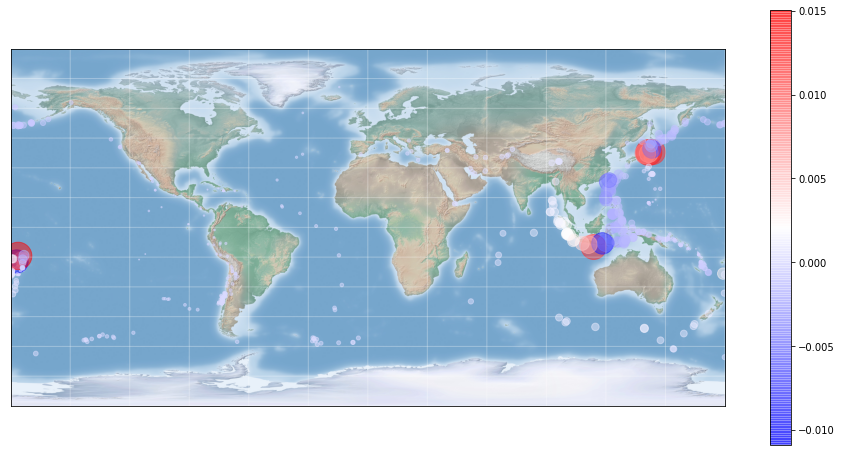

In [151]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp6,node_size = np.abs(_df.query('Year=="2010"').comp6)*50000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

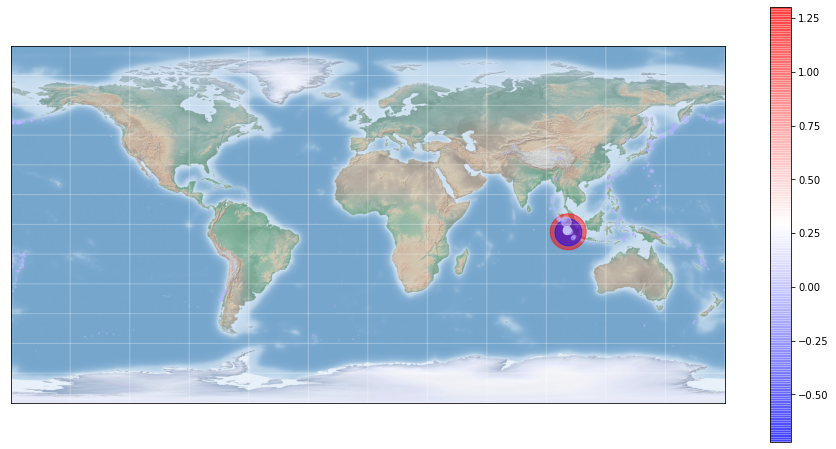

In [153]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp7,node_size = np.abs(_df.query('Year=="2010"').comp7)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2011**, $n=712$

In [154]:
_G8 = nx.Graph(_W[len(_df.query('Year<="2010"')):len(_df.query('Year<="2011"')),len(_df.query('Year<="2010"')):len(_df.query('Year<="2011"'))]-np.identity(len(_df.query('Year=="2011"'))))
_pos8 = nx.spring_layout(_G8,iterations=20)
m_pos8 = list(zip(_df.query('Year=="2011"').Longitude,_df.query('Year=="2011"').Latitude))

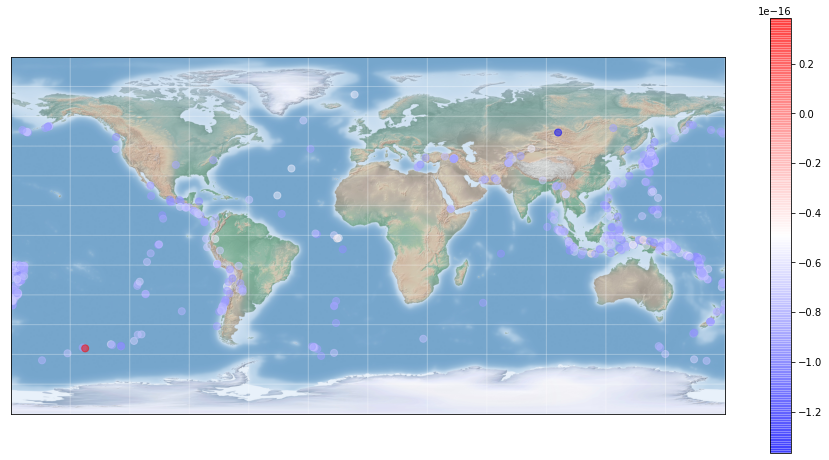

In [155]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

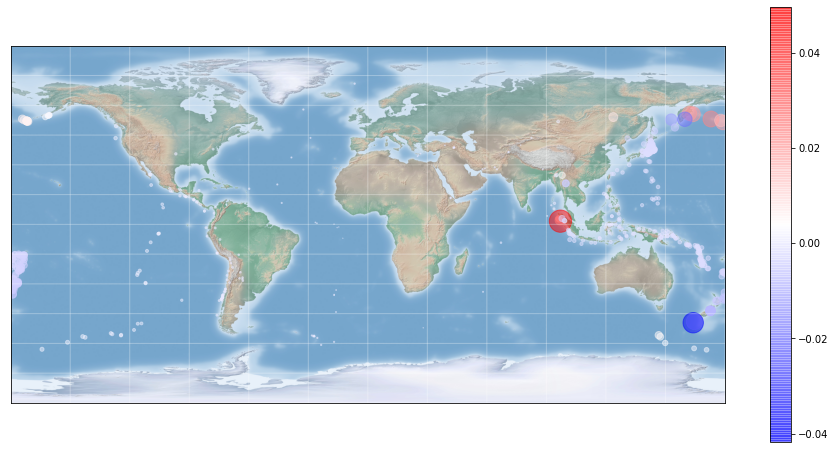

In [159]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp2,node_size = np.abs(_df.query('Year=="2011"').comp2)*10000,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

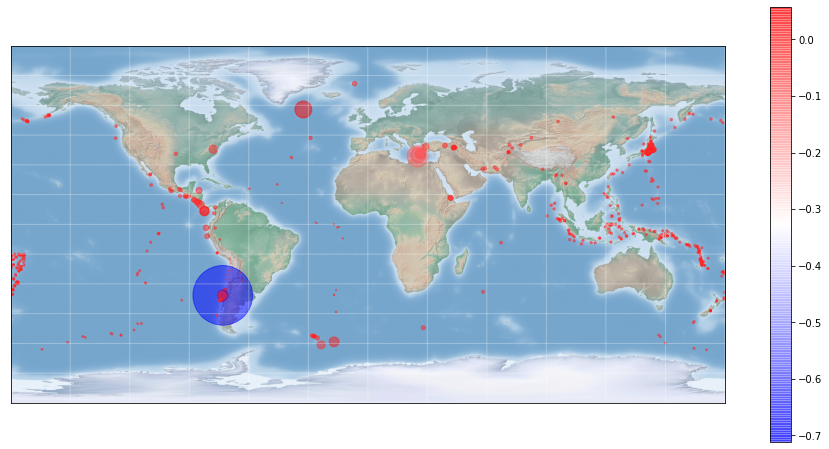

In [162]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp3,node_size = np.abs(_df.query('Year=="2011"').comp3)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

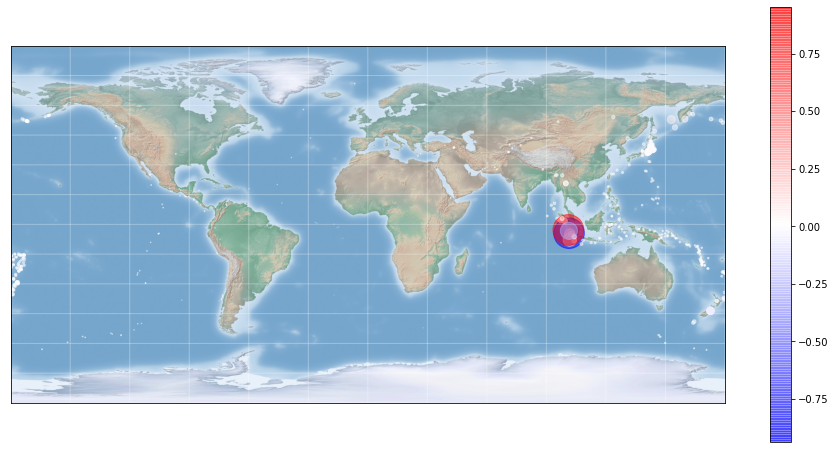

In [165]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp4,node_size = np.abs(_df.query('Year=="2011"').comp4)*1000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

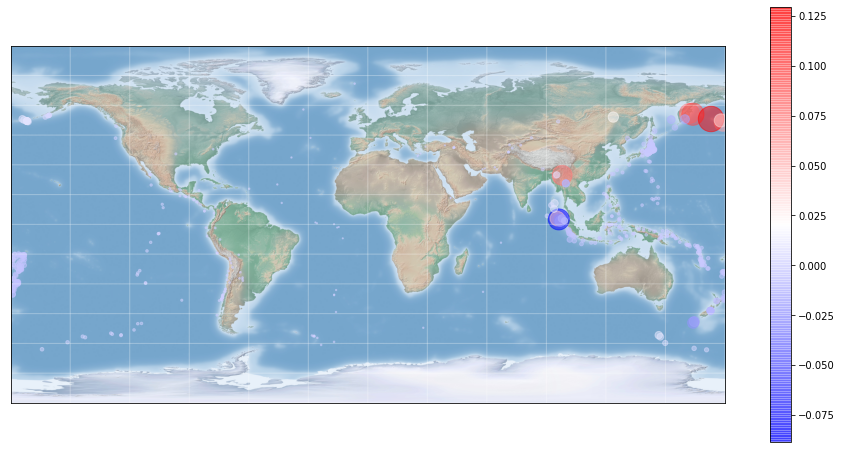

In [168]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp5,node_size = np.abs(_df.query('Year=="2011"').comp5)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

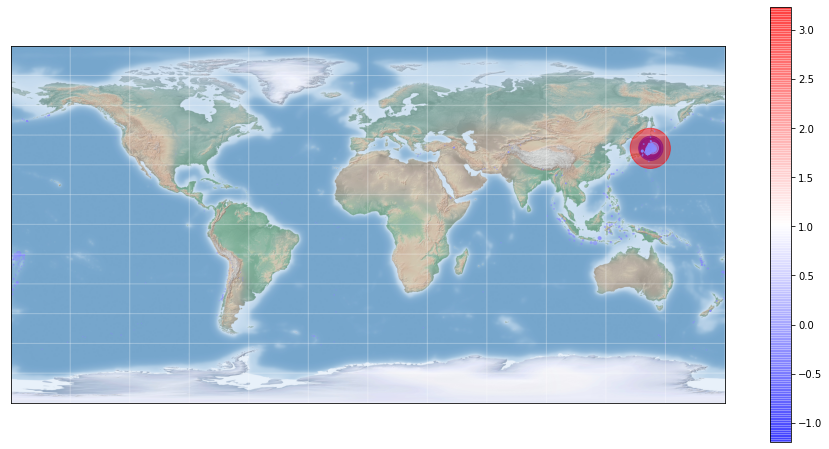

In [173]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp6,node_size = np.abs(_df.query('Year=="2011"').comp6)*500, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

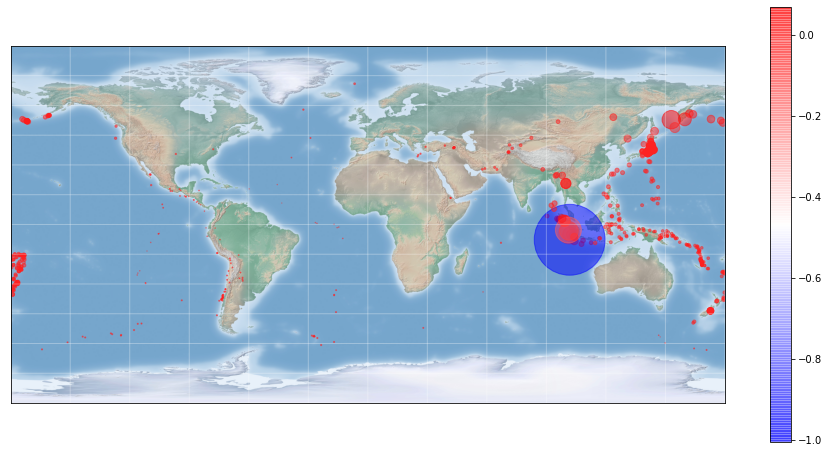

In [175]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp7,node_size = np.abs(_df.query('Year=="2011"').comp7)*5000, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)